In [10]:
#Librerias utilizadas
import numpy as np
import matplotlib.pyplot as plt
import os, glob, pydicom
import requests
import skimage.io as io
from skimage.color import rgb2gray

In [57]:
#Obtener una lista de los archivos en la carpeta mixed_Slices con extension .dcm
files = glob.glob(os.path.join('mixed_slices', '*.dcm'))
#Obtener los metadatos de las tomografias
x = pydicom.dcmread(os.path.join('mixed_slices','0.dcm'))
rows, cols = x.Rows, x.Columns
n_cuts = (123, 110, 114)

#Crear las variables para guardar los grupos de tomografias segun el paciente
vol1 = np.zeros((rows, cols, n_cuts[0]))
vol2 = np.zeros((rows, cols, n_cuts[1]))
vol3 = np.zeros((rows, cols, n_cuts[2]))

#Iterar los archivos y poner cada corte en el volumen y posicion adecuados
for file in files:
    cut = pydicom.dcmread(file)
    name = cut.PatientName
    if name == "CHAOS^CT_SET_8":
        vol1[:,:,cut.InstanceNumber-1] = cut.pixel_array
    elif name == "CHAOS^CT_SET_10":
        vol2[:,:,cut.InstanceNumber-1] = cut.pixel_array
    elif name == "CHAOS^CT_SET_26":
        vol3[:,:,cut.InstanceNumber-1] = cut.pixel_array

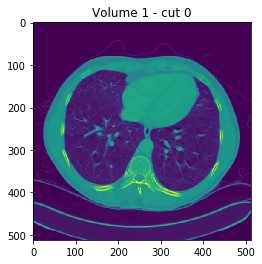

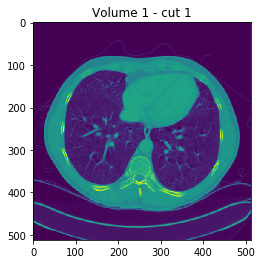

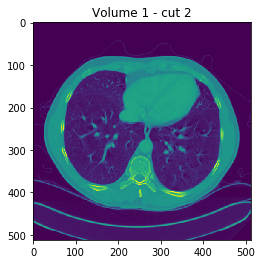

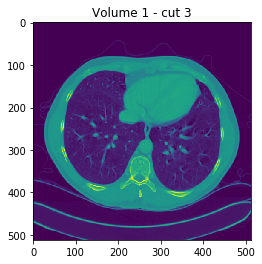

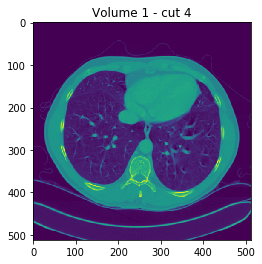

...

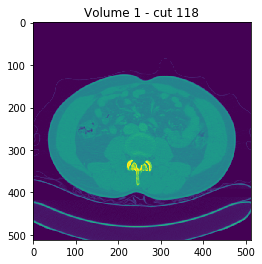

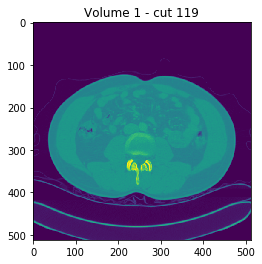

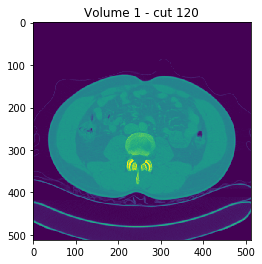

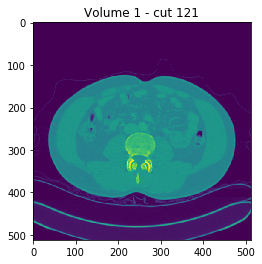

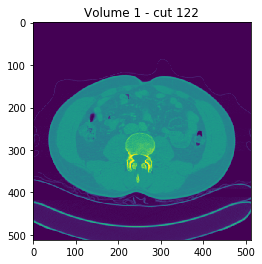

<Figure size 432x288 with 0 Axes>

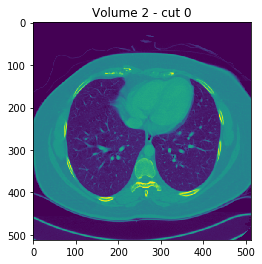

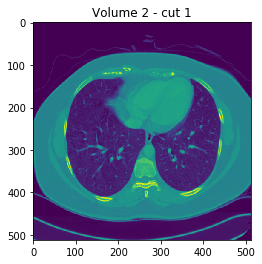

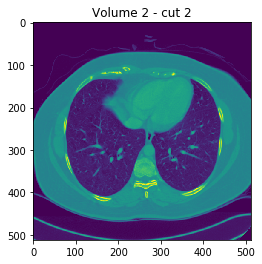

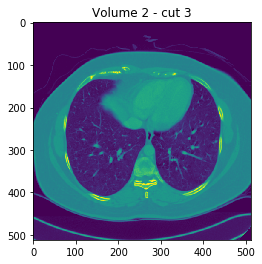

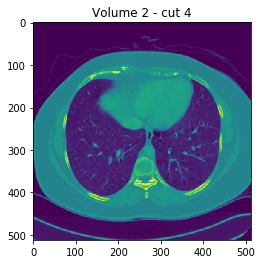

...

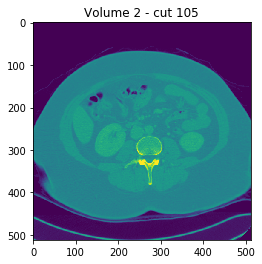

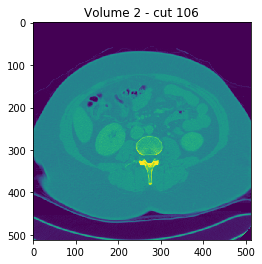

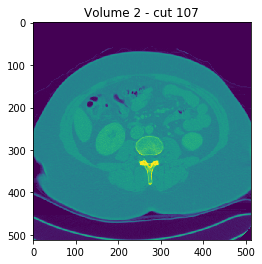

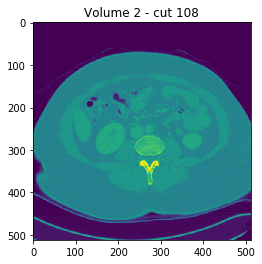

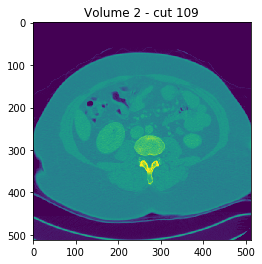

<Figure size 432x288 with 0 Axes>

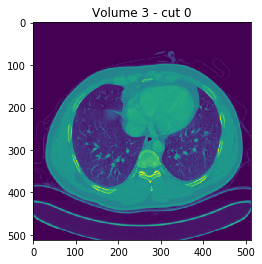

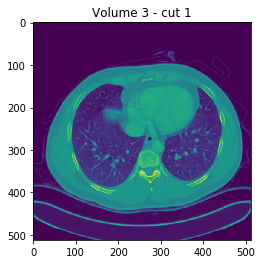

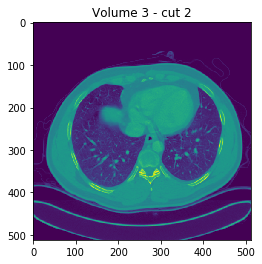

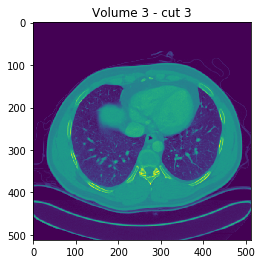

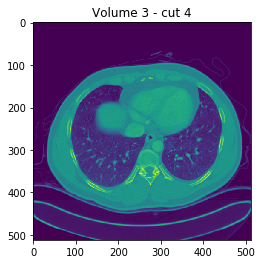

...

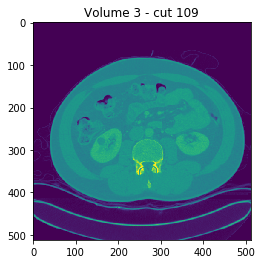

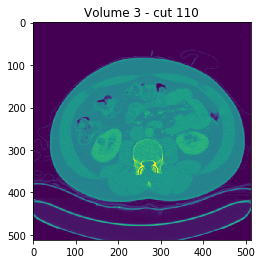

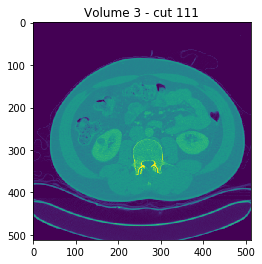

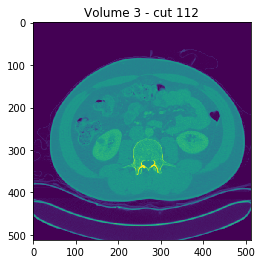

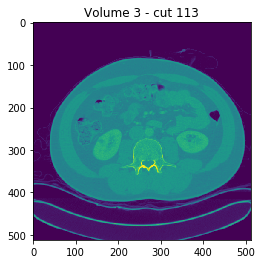

<Figure size 432x288 with 0 Axes>

In [65]:
for j in range(1,4):
    plt.ion()
    plt.show()
    for i in range(eval(f'(vol{j}.shape[2])')):
        eval(f'plt.imshow(vol{j}[:,:,i], vmin = 0, vmax = 2000)')
        plt.title(f'Volume {j} - cut {i}')
        plt.draw()
        plt.pause(0.001)
        plt.clf()